## LG 18650HG2 Li-ion Battery SOC Prediction - Convolutional Neural Net (CNN) and Fully Connected Network (FCN)
LG 18650HG2 Li-ion Battery Data - https://data.mendeley.com/datasets/cp3473x7xv/3

Kollmeyer, Philip; Vidal, Carlos; Naguib, Mina; Skells, Michael  (2020), “LG 18650HG2 Li-ion Battery Data and Example Deep Neural Network xEV SOC Estimator Script”, Mendeley Data, V3, doi: 10.17632/cp3473x7xv.3

### Helper functions

In [171]:
import os
import pandas as pd
import numpy as np
from datetime import datetime
from torch.utils.data import Dataset, DataLoader
import torch
import torch.nn as nn
import torch.optim as optim
import matplotlib.pyplot as plt
import seaborn as sns
import os
import pandas as pd
import torch

# Constants
DATA_PATH = r'C:\Users\Arpan\Documents\Python Scripts\ML\CNN_SOC\LG_HG2_Dataset'
RESAMPLE_RATE = '1S'
ROLLING_WINDOW = 500
MINMAX_NORM = True
BATCH_SIZE = 64
EPOCHS = 10

In [177]:
import os
import pandas as pd
import numpy as np
import pandas as pd
import collections
from datetime import datetime, timedelta

def normalization(dataset, minmax_norm):
    """
    Normalizes the dataset based on Min-Max or Z-score normalization.
    """
    return (dataset - dataset.min()) / (dataset.max() - dataset.min()) if minmax_norm else (dataset - dataset.mean()) / dataset.std()

    return dataset_norm


def get_files(data_path, drive_cycle_files, charge_cycle_files, temperature, get_discharge_only = True):

    # some LSTM training models require discharge cycles only
    if get_discharge_only:
        all_cycles = drive_cycle_files
    else:
        all_cycles = drive_cycle_files + charge_cycle_files

    # iterate thru each temperature folder and get drive cycle and corresponding charge files
    csv_files = []
    folders = os.listdir(data_path)
    for folder in folders:
        d = os.path.join(data_path, folder)
        if os.path.isdir(d):
            for file in os.listdir(d):
                if file.endswith('.csv') and any(substring in file for substring in all_cycles):
                    csv_files.append(data_path +'/'+ folder + '/' + file)

    # get the first valid index in each file and add it to the 'files' dictionary
    files = {}
    for csv_file in csv_files:
        if any('/'+ substring in csv_file for substring in temperature):
            df = pd.read_csv(csv_file, header=[25,26], index_col=0, parse_dates=True,nrows=26)
            files[str(df.first_valid_index())] = csv_file

    # sort the dictionary by time index
    od = collections.OrderedDict(sorted(files.items()))
    filtered = od.copy()

    # the ordered dictionary can have unnecessary charge files, pop them out
    # incorrect sequence can have - charge, charge, discharge, charge
    # with this section the file sequence will look like - discharge, charge, discharge..
    if not get_discharge_only:

        is_previous_charge = False
        is_previous_discharge = False

        for key, value in od.items():
            if not is_previous_discharge and any(substring in value for substring in drive_cycle_files):
                is_previous_discharge = True
                is_previous_charge = False
            elif not is_previous_charge and any(substring in value for substring in charge_cycle_files):
                if not is_previous_charge and not is_previous_discharge:
                    filtered.pop(key)
                is_previous_charge = True
                is_previous_discharge = False
            elif is_previous_discharge and any(substring in value for substring in drive_cycle_files):
                filtered.pop(key)
            elif is_previous_charge and any(substring in value for substring in charge_cycle_files):
                filtered.pop(key)

    return list(filtered.values())

def create_dataset(file_paths, drive_cycle_files, charge_cycle_files, vi_averages = True, resample_1hz = True, minmax_norm = True):

    for path in file_paths:
        cycle = pd.read_csv(path, header=[25,26], index_col=0, parse_dates=True)

        print(path + " " + str(cycle.shape[0]))

        #drop second row in the header
        cycle.columns = cycle.columns.droplevel(1)

        # calculate SOC Percentage + downsample discharge cycles, upsample charge cycles
        # - DISCHARGE FILES
        if any(substring in path for substring in drive_cycle_files):
            if resample_1hz:
                cycle = cycle.resample('1S').first()

            max_discharge = abs(min(cycle['Capacity']))
            cycle['Capacity'] = (cycle['Capacity'] + max_discharge)/max_discharge

        # - CHARGE FILES
        elif any(substring in path for substring in charge_cycle_files):
            if resample_1hz:
                cycle = cycle[~cycle.index.duplicated(keep='first')]
                cycle = cycle.resample('1S').ffill()

            max_charge = abs(max(cycle['Capacity']))
            cycle['Capacity'] = (cycle['Capacity'])/max_charge

        # leave out 'PAU' rows from the cycle
        options = ['CHA', 'DCH', 'TABLE']
        cycle = cycle[cycle['Status'].isin(options)]

        # calculate 'Power'
        cycle['Power'] = cycle['Voltage'] * cycle['Current']

        # select required features
        parameters = cycle[['Voltage', 'Current', 'Temperature', 'Power', 'Capacity']].copy()

        # calculate 'Voltage', 'Current' and 'Power' averages
        # 500 second rolling window which translates to rougly 500 data points for resampled data and 5000 for raw data
        rolling_window = 5000
        if vi_averages and resample_1hz:
            rolling_window = int(rolling_window / 10)

        if vi_averages:
            parameters['Voltage Average'] = parameters['Voltage'].rolling(rolling_window).mean()
            parameters['Current Average'] = parameters['Current'].rolling(rolling_window).mean()
            parameters['Power Average'] = parameters['Power'].rolling(rolling_window).mean()

        # drop rows with NaN or empty values in them, reset the index to reflect
        parameters.dropna(inplace=True)
        parameters.reset_index(drop=True, inplace=True)

        # merge datasets
        try:
            merged = pd.concat([merged, parameters], ignore_index=True)
        except:
            merged = parameters.copy()

    merged_norm = normalization(merged, minmax_norm)

    return merged, merged_norm


# # create_lstm_dataset - https://github.com/KeiLongW/battery-state-estimation
# def create_lstm_dataset(dataset, steps):
#     dataset.drop(['Power', 'Power Average'], axis=1, inplace=True)
#     train_y = dataset.pop('Capacity').to_numpy()
#     train_y = train_y.reshape(len(train_y),1)
#     train_x = dataset.to_numpy()

#     x_length = len(train_x[0])
#     y_length = len(train_y[0])
#     x = np.empty((0, steps, x_length), float)
#     y = np.empty((0, steps, y_length), float)

#     number_subsequences = int(len(train_x)/steps)

#     for i in range(0, number_subsequences*steps, steps):
#         next_x = np.array(train_x[i:i + steps]).reshape(1, steps, x_length)
#         next_y = np.array(train_y[i:i + steps]).reshape(1, steps, y_length)
#         x = np.concatenate((x, next_x))
#         y = np.concatenate((y, next_y))

#     return x, y

# keep_only_y_end - https://github.com/KeiLongW/battery-state-estimation
def keep_only_y_end(y, step):
    return y[:,::step]


def convert_to_tensor(df):
    return torch.tensor(df.values, dtype=torch.float32)

### Load files

In [178]:
# Data paths and other parameters
train_discharge_cycles = ['Mixed']
charge_cycles = ['Charge']
train_temps = ['n10degC', '0degC', '10degC', '25degC']
test_discharge_cycles = ['UDDS', 'HWFET', 'LA92', 'US06']
test_temps = ['n10degC', '0degC', '10degC', '25degC']

# Load and preprocess data
train_files = get_files(DATA_PATH, train_discharge_cycles, charge_cycles, train_temps)
test_files = get_files(DATA_PATH, test_discharge_cycles, charge_cycles, test_temps)

# Create datasets
train_df, _ = create_dataset(train_files, train_discharge_cycles, charge_cycles, resample_1hz=RESAMPLE_RATE, minmax_norm=MINMAX_NORM)
test_df, _ = create_dataset(test_files, test_discharge_cycles, charge_cycles, resample_1hz=RESAMPLE_RATE, minmax_norm=MINMAX_NORM)

# Extract 'Capacity' as labels and normalize features
train_labels = train_df.pop('Capacity')
test_labels = test_df.pop('Capacity')
train_features = normalization(train_df, True)
test_features = normalization(test_df, True)

# Convert to PyTorch tensors
train_features_tensor = torch.tensor(train_features.values, dtype=torch.float32)
train_labels_tensor = torch.tensor(train_labels.values, dtype=torch.float32).view(-1, 1)
test_features_tensor = torch.tensor(test_features.values, dtype=torch.float32)
test_labels_tensor = torch.tensor(test_labels.values, dtype=torch.float32).view(-1, 1)

# Now you can get the shape of the labels and the features (after popping the labels)
print(f"Shape of train_features (after popping labels): {train_features.shape}")
print(f"Shape of train_labels: {train_labels.shape}")
print(f"Shape of test_features (after popping labels): {test_features.shape}")
print(f"Shape of test_labels: {test_labels.shape}")

C:\Users\Arpan\AppData\Local\Temp\ipykernel_4180\3943473996.py:39: UserWarning:

Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.

C:\Users\Arpan\AppData\Local\Temp\ipykernel_4180\3943473996.py:39: UserWarning:

Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.

C:\Users\Arpan\AppData\Local\Temp\ipykernel_4180\3943473996.py:39: UserWarning:

Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.

C:\Users\Arpan\AppData\Local\Temp\ipykernel_4180\3943473996.py:39: UserWarning:

Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify

C:\Users\Arpan\Documents\Python Scripts\ML\CNN_SOC\LG_HG2_Dataset/25degC/551_Mixed1.csv 77227


C:\Users\Arpan\AppData\Local\Temp\ipykernel_4180\3943473996.py:73: UserWarning:

Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.



C:\Users\Arpan\Documents\Python Scripts\ML\CNN_SOC\LG_HG2_Dataset/25degC/551_Mixed2.csv 79172
C:\Users\Arpan\Documents\Python Scripts\ML\CNN_SOC\LG_HG2_Dataset/25degC/552_Mixed3.csv 73827
C:\Users\Arpan\Documents\Python Scripts\ML\CNN_SOC\LG_HG2_Dataset/25degC/552_Mixed4.csv 80850


C:\Users\Arpan\AppData\Local\Temp\ipykernel_4180\3943473996.py:73: UserWarning:

Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.



C:\Users\Arpan\Documents\Python Scripts\ML\CNN_SOC\LG_HG2_Dataset/25degC/552_Mixed5.csv 72184


C:\Users\Arpan\AppData\Local\Temp\ipykernel_4180\3943473996.py:73: UserWarning:

Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.



C:\Users\Arpan\Documents\Python Scripts\ML\CNN_SOC\LG_HG2_Dataset/25degC/552_Mixed6.csv 78106
C:\Users\Arpan\Documents\Python Scripts\ML\CNN_SOC\LG_HG2_Dataset/25degC/552_Mixed7.csv 73235
C:\Users\Arpan\Documents\Python Scripts\ML\CNN_SOC\LG_HG2_Dataset/25degC/552_Mixed8.csv 85915


C:\Users\Arpan\AppData\Local\Temp\ipykernel_4180\3943473996.py:73: UserWarning:

Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.



C:\Users\Arpan\Documents\Python Scripts\ML\CNN_SOC\LG_HG2_Dataset/10degC/567_Mixed1.csv 72329
C:\Users\Arpan\Documents\Python Scripts\ML\CNN_SOC\LG_HG2_Dataset/10degC/567_Mixed2.csv 77752


C:\Users\Arpan\AppData\Local\Temp\ipykernel_4180\3943473996.py:73: UserWarning:

Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.



C:\Users\Arpan\Documents\Python Scripts\ML\CNN_SOC\LG_HG2_Dataset/10degC/571_Mixed4.csv 73929


C:\Users\Arpan\AppData\Local\Temp\ipykernel_4180\3943473996.py:73: UserWarning:

Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.



C:\Users\Arpan\Documents\Python Scripts\ML\CNN_SOC\LG_HG2_Dataset/10degC/571_Mixed5.csv 67174
C:\Users\Arpan\Documents\Python Scripts\ML\CNN_SOC\LG_HG2_Dataset/10degC/571_Mixed6.csv 73921


C:\Users\Arpan\AppData\Local\Temp\ipykernel_4180\3943473996.py:73: UserWarning:

Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.



C:\Users\Arpan\Documents\Python Scripts\ML\CNN_SOC\LG_HG2_Dataset/10degC/571_Mixed7.csv 69325


C:\Users\Arpan\AppData\Local\Temp\ipykernel_4180\3943473996.py:73: UserWarning:

Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.



C:\Users\Arpan\Documents\Python Scripts\ML\CNN_SOC\LG_HG2_Dataset/10degC/571_Mixed8.csv 81422


C:\Users\Arpan\AppData\Local\Temp\ipykernel_4180\3943473996.py:73: UserWarning:

Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.



C:\Users\Arpan\Documents\Python Scripts\ML\CNN_SOC\LG_HG2_Dataset/0degC/589_Mixed1.csv 67312
C:\Users\Arpan\Documents\Python Scripts\ML\CNN_SOC\LG_HG2_Dataset/0degC/589_Mixed2.csv 72303


C:\Users\Arpan\AppData\Local\Temp\ipykernel_4180\3943473996.py:73: UserWarning:

Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.



C:\Users\Arpan\Documents\Python Scripts\ML\CNN_SOC\LG_HG2_Dataset/0degC/590_Mixed4.csv 68027


C:\Users\Arpan\AppData\Local\Temp\ipykernel_4180\3943473996.py:73: UserWarning:

Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.



C:\Users\Arpan\Documents\Python Scripts\ML\CNN_SOC\LG_HG2_Dataset/0degC/590_Mixed5.csv 64995


C:\Users\Arpan\AppData\Local\Temp\ipykernel_4180\3943473996.py:73: UserWarning:

Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.



C:\Users\Arpan\Documents\Python Scripts\ML\CNN_SOC\LG_HG2_Dataset/0degC/590_Mixed6.csv 62483
C:\Users\Arpan\Documents\Python Scripts\ML\CNN_SOC\LG_HG2_Dataset/0degC/590_Mixed7.csv 61540
C:\Users\Arpan\Documents\Python Scripts\ML\CNN_SOC\LG_HG2_Dataset/0degC/590_Mixed8.csv 75838
C:\Users\Arpan\Documents\Python Scripts\ML\CNN_SOC\LG_HG2_Dataset/n10degC/601_Mixed1.csv 62622
C:\Users\Arpan\Documents\Python Scripts\ML\CNN_SOC\LG_HG2_Dataset/n10degC/601_Mixed2.csv 65254


C:\Users\Arpan\AppData\Local\Temp\ipykernel_4180\3943473996.py:73: UserWarning:

Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.



C:\Users\Arpan\Documents\Python Scripts\ML\CNN_SOC\LG_HG2_Dataset/n10degC/602_Mixed4.csv 65677
C:\Users\Arpan\Documents\Python Scripts\ML\CNN_SOC\LG_HG2_Dataset/n10degC/602_Mixed5.csv 60087
C:\Users\Arpan\Documents\Python Scripts\ML\CNN_SOC\LG_HG2_Dataset/n10degC/604_Mixed3.csv 55214
C:\Users\Arpan\Documents\Python Scripts\ML\CNN_SOC\LG_HG2_Dataset/n10degC/604_Mixed6.csv 55968
C:\Users\Arpan\Documents\Python Scripts\ML\CNN_SOC\LG_HG2_Dataset/n10degC/604_Mixed7.csv 55940


C:\Users\Arpan\AppData\Local\Temp\ipykernel_4180\3943473996.py:73: UserWarning:

Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.



C:\Users\Arpan\Documents\Python Scripts\ML\CNN_SOC\LG_HG2_Dataset/n10degC/604_Mixed8.csv 67325


C:\Users\Arpan\AppData\Local\Temp\ipykernel_4180\3943473996.py:73: UserWarning:

Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.



C:\Users\Arpan\Documents\Python Scripts\ML\CNN_SOC\LG_HG2_Dataset/25degC/551_UDDS.csv 159646
C:\Users\Arpan\Documents\Python Scripts\ML\CNN_SOC\LG_HG2_Dataset/25degC/551_HWFET.csv 6002
C:\Users\Arpan\Documents\Python Scripts\ML\CNN_SOC\LG_HG2_Dataset/25degC/551_LA92.csv 100764
C:\Users\Arpan\Documents\Python Scripts\ML\CNN_SOC\LG_HG2_Dataset/25degC/551_US06.csv 40155


C:\Users\Arpan\AppData\Local\Temp\ipykernel_4180\3943473996.py:73: UserWarning:

Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.



C:\Users\Arpan\Documents\Python Scripts\ML\CNN_SOC\LG_HG2_Dataset/10degC/567_US06.csv 38718
C:\Users\Arpan\Documents\Python Scripts\ML\CNN_SOC\LG_HG2_Dataset/10degC/576_UDDS.csv 148898
C:\Users\Arpan\Documents\Python Scripts\ML\CNN_SOC\LG_HG2_Dataset/10degC/576_HWFET.csv 52878


C:\Users\Arpan\AppData\Local\Temp\ipykernel_4180\3943473996.py:73: UserWarning:

Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.



C:\Users\Arpan\Documents\Python Scripts\ML\CNN_SOC\LG_HG2_Dataset/10degC/582_LA92.csv 90740
C:\Users\Arpan\Documents\Python Scripts\ML\CNN_SOC\LG_HG2_Dataset/0degC/589_UDDS.csv 140435
C:\Users\Arpan\Documents\Python Scripts\ML\CNN_SOC\LG_HG2_Dataset/0degC/589_HWFET.csv 49678


C:\Users\Arpan\AppData\Local\Temp\ipykernel_4180\3943473996.py:73: UserWarning:

Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.



C:\Users\Arpan\Documents\Python Scripts\ML\CNN_SOC\LG_HG2_Dataset/0degC/589_LA92.csv 81577


C:\Users\Arpan\AppData\Local\Temp\ipykernel_4180\3943473996.py:73: UserWarning:

Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.



C:\Users\Arpan\Documents\Python Scripts\ML\CNN_SOC\LG_HG2_Dataset/0degC/589_US06.csv 33806


C:\Users\Arpan\AppData\Local\Temp\ipykernel_4180\3943473996.py:73: UserWarning:

Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.



C:\Users\Arpan\Documents\Python Scripts\ML\CNN_SOC\LG_HG2_Dataset/n10degC/596_UDDS.csv 123602
C:\Users\Arpan\Documents\Python Scripts\ML\CNN_SOC\LG_HG2_Dataset/n10degC/596_HWFET.csv 44903
C:\Users\Arpan\Documents\Python Scripts\ML\CNN_SOC\LG_HG2_Dataset/n10degC/596_LA92.csv 72098
C:\Users\Arpan\Documents\Python Scripts\ML\CNN_SOC\LG_HG2_Dataset/n10degC/601_US06.csv 31913
Shape of lg_train_features (after popping labels): (176334, 7)
Shape of lg_train_labels: (176334,)
Shape of lg_test_features (after popping labels): (104485, 7)
Shape of lg_test_labels: (104485,)


### LG Training dataframe, and Test dataframe Stats

In [179]:
print("Train features shape:", train_features.shape)
print("Test features shape:", test_features.shape)
print("Train labels shape:", train_labels.shape)
print("Test labels shape:", test_labels.shape)

Train features shape: (176334, 7)
Test features shape: (104485, 7)
Train labels shape: (176334,)
Test labels shape: (104485,)


In [180]:
train_df.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
Time Stamp,,,,,,,,
Voltage,176334.0,3.665063,0.262172,2.792680,3.494900,3.672220,3.859490,4.200630
Current,176334.0,-1.333758,2.561152,-17.822440,-2.556640,-0.950120,-0.097060,5.999610
Temperature,176334.0,7.891981,12.526156,-9.884900,-0.315480,9.359110,23.976150,26.289630
Power,176334.0,-4.596105,8.941956,-50.862673,-9.210683,-3.477834,-0.386161,25.171220
Voltage Average,176334.0,3.699654,0.226606,3.094354,3.521361,3.694212,3.889611,4.139058
Current Average,176334.0,-1.296481,0.711963,-3.715850,-1.720026,-1.162827,-0.772447,-0.277316
Power Average,176334.0,-4.522300,2.410210,-11.429077,-5.996818,-4.127167,-2.722423,-1.079428


In [181]:
test_df.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
Time Stamp,,,,,,,,
Voltage,104485.0,3.677951,0.261341,2.794030,3.496920,3.689080,3.885750,4.200120
Current,104485.0,-1.098654,2.357463,-17.610450,-2.191410,-0.625750,-0.084280,5.999610
Temperature,104485.0,6.921388,12.063139,-10.095220,-0.420630,9.148790,23.765830,26.815430
Power,104485.0,-3.776420,8.243404,-50.864924,-7.916661,-2.317480,-0.316026,25.142453
Voltage Average,104485.0,3.704737,0.229296,3.049658,3.523629,3.716103,3.900654,4.110299
Current Average,104485.0,-1.097331,0.728330,-3.810095,-1.335683,-0.867386,-0.523847,-0.311306
Power Average,104485.0,-3.824287,2.439860,-11.887300,-4.544482,-3.073238,-1.888219,-1.210706


### LG Dataset Figures, Distribution

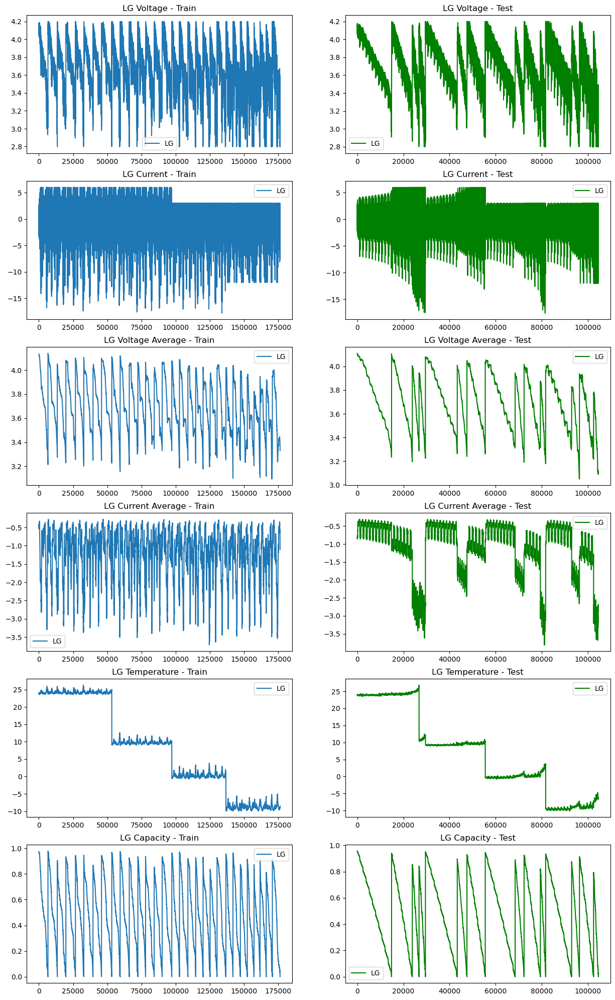

In [91]:
plot_cols = ['Voltage', 'Current', 'Voltage Average', 'Current Average', 'Temperature', 'Capacity']

fig, axs = plt.subplots(nrows=len(plot_cols), ncols=2, figsize=(15, 25))

for i, col in enumerate(plot_cols):
    axs[i, 0].plot(train_df[col], label='LG')
    axs[i, 0].set_title(f'LG {col} - Train')
    axs[i, 0].legend()
    
    axs[i, 1].plot(test_df[col], label='LG', color="green")
    axs[i, 1].set_title(f'LG {col} - Test')
    axs[i, 1].legend()

#### Correlation Heatmap: 
Shows the correlation coefficients between variables. It's helpful for understanding the relationships between different features.

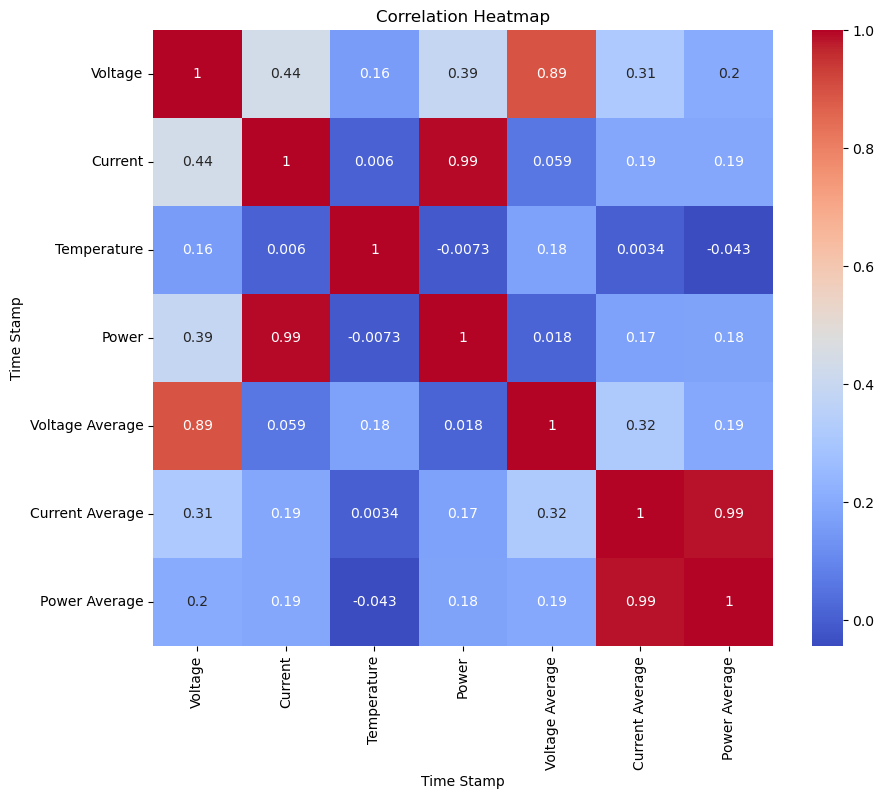

In [148]:
plt.figure(figsize=(10, 8))
sns.heatmap(train_df.corr(), annot=True, cmap='coolwarm')
plt.title('Correlation Heatmap')
plt.show()

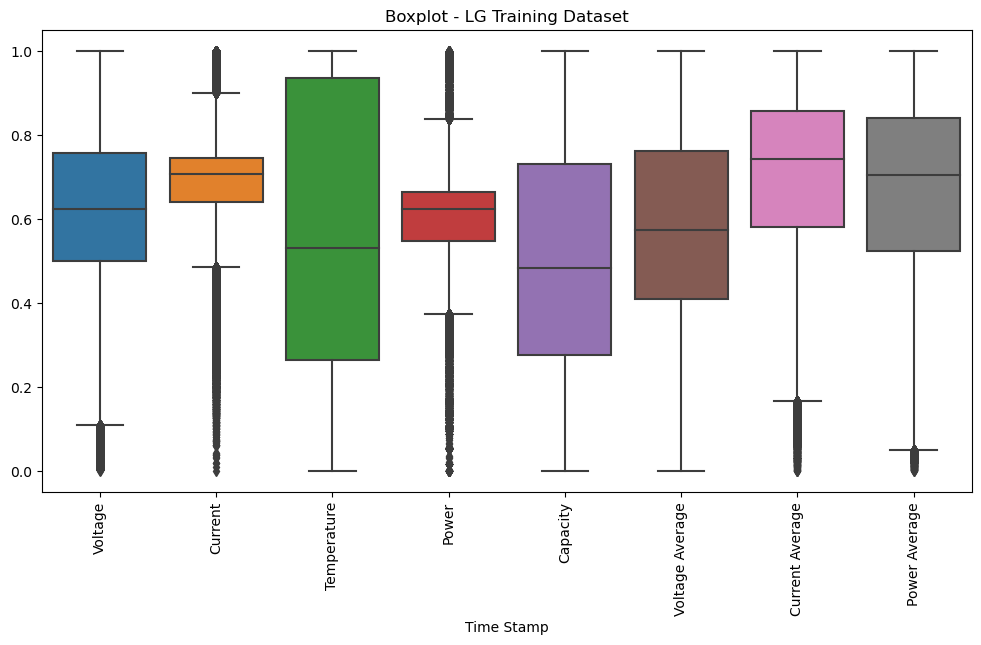

In [140]:
plt.figure(figsize=(12, 6))
sns.boxplot(data=train_df_norm)
plt.xticks(rotation=90)
plt.title('Boxplot - LG Training Dataset')
plt.show()

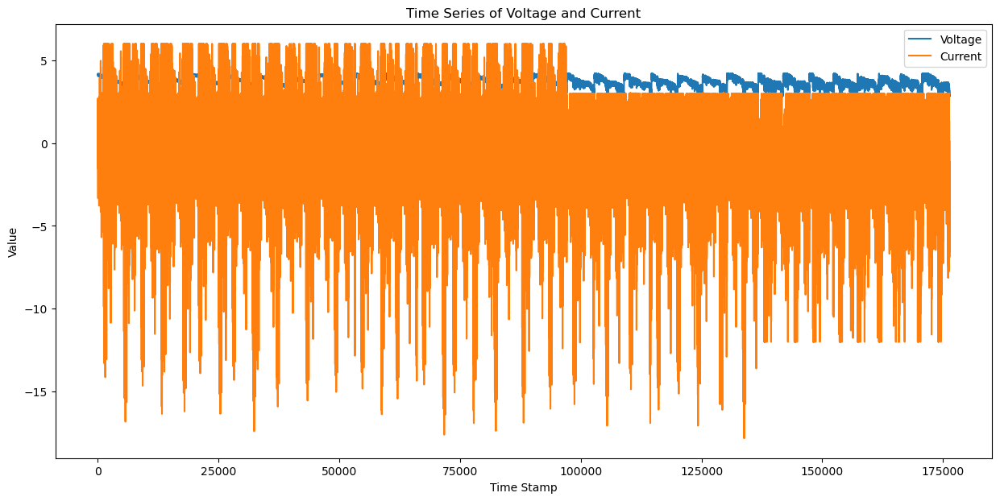

In [143]:
plt.figure(figsize=(15, 7))
plt.plot(train_df['Voltage'], label='Voltage')
plt.plot(train_df['Current'], label='Current')
plt.xlabel('Time Stamp')
plt.ylabel('Value')
plt.title('Time Series of Voltage and Current')
plt.legend()
plt.show()

## CNN MODEL TRAINING

In [182]:
class CNN1DModel(nn.Module):
    def __init__(self, input_size):
        super(CNN1DModel, self).__init__()
        # Define the layers of the model
        self.conv1 = nn.Conv1d(in_channels=1, out_channels=32, kernel_size=input_size)
        self.fc1 = nn.Linear(32, 32)  # The input features to this layer depend on the output of conv1
        self.fc2 = nn.Linear(32, 1)
        
    def forward(self, x):
        # Apply the first convolutional layer followed by ReLU
        x = F.relu(self.conv1(x))
        # Flatten the output for the fully connected layer
        x = torch.flatten(x, 1)
        # Apply the first dense (fully connected) layer followed by ReLU
        x = F.relu(self.fc1(x))
        # Apply the second dense layer
        x = self.fc2(x)
        return x

In [183]:
from numpy import reshape, array
# reshape for CNN 1-D
train_array = array(train_features)
labels_array = array(train_labels)

sample_size = train_features.shape[0]
time_steps = train_features.shape[1]
input_dimension = 1

train_reshaped = train_array.reshape((sample_size,time_steps,1))
labels_reshaped = labels_array.reshape((train_labels.shape[0],1,1))

print(train_reshaped.shape)
print(labels_reshaped.shape)

(176334, 7, 1)
(176334, 1, 1)


Epoch 1/50, Train Loss: 0.019564, Validation Loss: 0.016670
Epoch 2/50, Train Loss: 0.013415, Validation Loss: 0.011904
Epoch 3/50, Train Loss: 0.011686, Validation Loss: 0.009923
Epoch 4/50, Train Loss: 0.010643, Validation Loss: 0.009632
Epoch 5/50, Train Loss: 0.010133, Validation Loss: 0.014662
Epoch 6/50, Train Loss: 0.010021, Validation Loss: 0.008880
Epoch 7/50, Train Loss: 0.009598, Validation Loss: 0.008676
Epoch 8/50, Train Loss: 0.009491, Validation Loss: 0.008549
Epoch 9/50, Train Loss: 0.009226, Validation Loss: 0.011048
Epoch 10/50, Train Loss: 0.009074, Validation Loss: 0.008330
Epoch 11/50, Train Loss: 0.008928, Validation Loss: 0.007838
Epoch 12/50, Train Loss: 0.008824, Validation Loss: 0.007778
Epoch 13/50, Train Loss: 0.008553, Validation Loss: 0.008011
Epoch 14/50, Train Loss: 0.008367, Validation Loss: 0.010408
Epoch 15/50, Train Loss: 0.008315, Validation Loss: 0.008068
Epoch 16/50, Train Loss: 0.008263, Validation Loss: 0.007449
Epoch 17/50, Train Loss: 0.008230

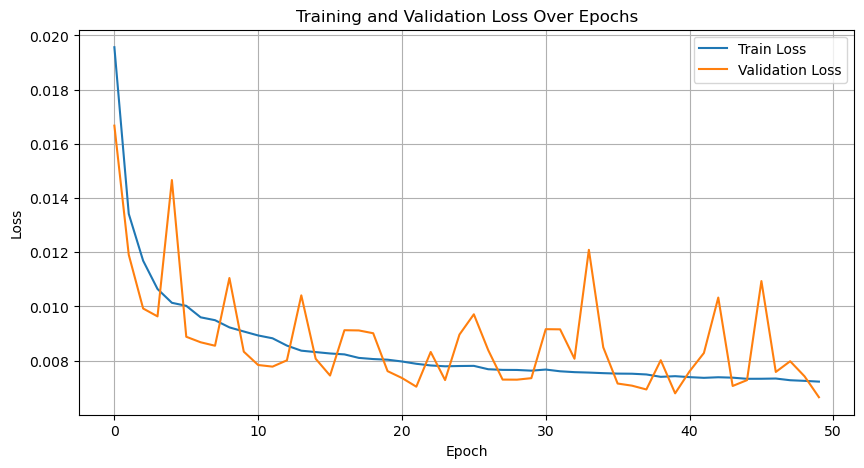

In [184]:
from torch.utils.data import TensorDataset, DataLoader, random_split

train_features_tensor = torch.tensor(train_features.values, dtype=torch.float32).unsqueeze(1)  # Add channel dimension
train_labels_tensor = torch.tensor(train_labels.values, dtype=torch.float32).unsqueeze(1)  # Reshape labels

# Splitting the dataset into training and validation sets
dataset = TensorDataset(train_features_tensor, train_labels_tensor)
train_size = int(0.8 * len(dataset))
val_size = len(dataset) - train_size
train_dataset, val_dataset = random_split(dataset, [train_size, val_size])

# Creating data loaders for training and validation sets
train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=32, shuffle=False)

def train_and_validate(model, criterion, optimizer, train_loader, val_loader, epochs, device):
    history = {'train_loss': [], 'val_loss': []}
    
    for epoch in range(epochs):
        # Training phase
        model.train()
        running_loss = 0.0
        for inputs, labels in train_loader:
            inputs, labels = inputs.to(device), labels.to(device)

            optimizer.zero_grad()
            outputs = model(inputs)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()
            running_loss += loss.item()
        
        train_loss = running_loss / len(train_loader)
        history['train_loss'].append(train_loss)

        # Validation phase
        model.eval()
        val_loss = 0.0
        with torch.no_grad():
            for inputs, labels in val_loader:
                inputs, labels = inputs.to(device), labels.to(device)
                outputs = model(inputs)
                loss = criterion(outputs, labels)
                val_loss += loss.item()

        val_loss = val_loss / len(val_loader)
        history['val_loss'].append(val_loss)

        print(f'Epoch {epoch + 1}/{epochs}, Train Loss: {train_loss:.6f}, Validation Loss: {val_loss:.6f}')

    return history

model = CNN1DModel(num_features)
criterion = nn.L1Loss()  # MAE Loss
optimizer = optim.Adam(model.parameters(), lr=0.001)

# Training loop
num_epochs = 50
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
model.to(device)

# Train and validate the model
history = train_and_validate(model, criterion, optimizer, train_loader, val_loader, num_epochs, device)

torch.save(model, 'CNN1DModel.pth')

# Plot the training history
plt.figure(figsize=(10, 5))
plt.plot(history['train_loss'], label='Train Loss')
plt.plot(history['val_loss'], label='Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training and Validation Loss Over Epochs')
plt.legend()
plt.grid(True)
plt.show()

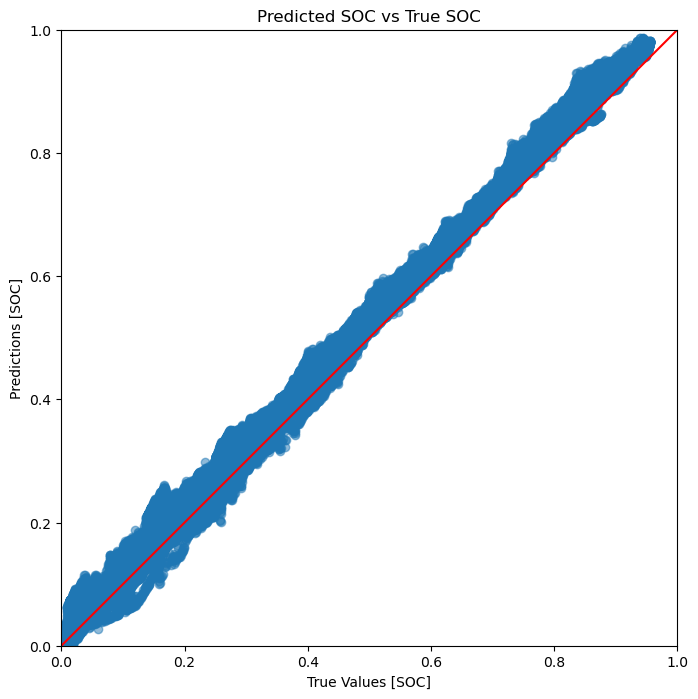

In [185]:
test_features_tensor = torch.tensor(test_features.values, dtype=torch.float32).unsqueeze(1)
# Create a DataLoader for the test set
test_loader = DataLoader(TensorDataset(test_features_tensor, test_labels_tensor), batch_size=64, shuffle=False)

model.to(device)

def test_model(model, test_loader, device):
    model = torch.load('CNN1DModel.pth')
    model.eval()
    test_predictions = []
    test_targets = []
    
    with torch.no_grad():
        for inputs, labels in test_loader:
            inputs, labels = inputs.to(device), labels.to(device)
            outputs = model(inputs)
            test_predictions.extend(outputs.cpu().view(-1).tolist())
            test_targets.extend(labels.cpu().view(-1).tolist())  
    
    return test_predictions, test_targets

# Evaluate the model
test_predictions, test_targets = test_model(model, test_loader, device)

plt.figure(figsize=(8, 8))
plt.scatter(test_targets, test_predictions, alpha=0.5)
plt.xlabel('True Values [SOC]')
plt.ylabel('Predictions [SOC]')
plt.axis('equal')
plt.axis('square')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.plot([0, 1], [0, 1], color='red')  # Diagonal line
plt.title('Predicted SOC vs True SOC')
plt.show()

In [186]:
import plotly.graph_objects as go
import numpy as np

cycle_num = 0
steps_num = 100000
step_index = np.arange(cycle_num * steps_num, (cycle_num + 1) * steps_num)

# Ensure the sliced arrays are of equal length
min_length = min(len(test_predictions), len(test_targets), len(test_features['Temperature']))

fig = go.Figure()
fig.add_trace(go.Scatter(x=step_index[:min_length], y=test_predictions[:min_length], mode='lines', name='SOC Predicted'))
fig.add_trace(go.Scatter(x=step_index[:min_length], y=test_targets[:min_length], mode='lines', name='SOC Actual'))
fig.add_trace(go.Scatter(x=step_index[:min_length], y=test_features['Temperature'][:min_length], mode='lines', name='Temperature'))

fig.update_layout(title='Result on Test Dataset', xaxis_title='Step', yaxis_title='SOC Percentage')
fig.show()


### FC Model

In [187]:
class FCModel(nn.Module):
    def __init__(self, input_size):
        super(FCModel, self).__init__()
        self.fc1 = nn.Linear(input_size, 64)
        self.fc2 = nn.Linear(64, 32)
        self.fc3 = nn.Linear(32, 1)

    def forward(self, x):
        x = F.relu(self.fc1(x))
        x = F.relu(self.fc2(x))
        x = self.fc3(x)
        x = x.squeeze(-1) 
        return x

Epoch 1/50, Train Loss: 0.018364, Validation Loss: 0.018175
Epoch 2/50, Train Loss: 0.011510, Validation Loss: 0.014245
Epoch 3/50, Train Loss: 0.010445, Validation Loss: 0.009412
Epoch 4/50, Train Loss: 0.009772, Validation Loss: 0.008588
Epoch 5/50, Train Loss: 0.009371, Validation Loss: 0.009483
Epoch 6/50, Train Loss: 0.009135, Validation Loss: 0.008510
Epoch 7/50, Train Loss: 0.008964, Validation Loss: 0.008181
Epoch 8/50, Train Loss: 0.008738, Validation Loss: 0.009166
Epoch 9/50, Train Loss: 0.008637, Validation Loss: 0.008329
Epoch 10/50, Train Loss: 0.008567, Validation Loss: 0.007712
Epoch 11/50, Train Loss: 0.008576, Validation Loss: 0.008738
Epoch 12/50, Train Loss: 0.008476, Validation Loss: 0.008507
Epoch 13/50, Train Loss: 0.008331, Validation Loss: 0.009156
Epoch 14/50, Train Loss: 0.008282, Validation Loss: 0.009648
Epoch 15/50, Train Loss: 0.008171, Validation Loss: 0.009322
Epoch 16/50, Train Loss: 0.008152, Validation Loss: 0.009300
Epoch 17/50, Train Loss: 0.008056

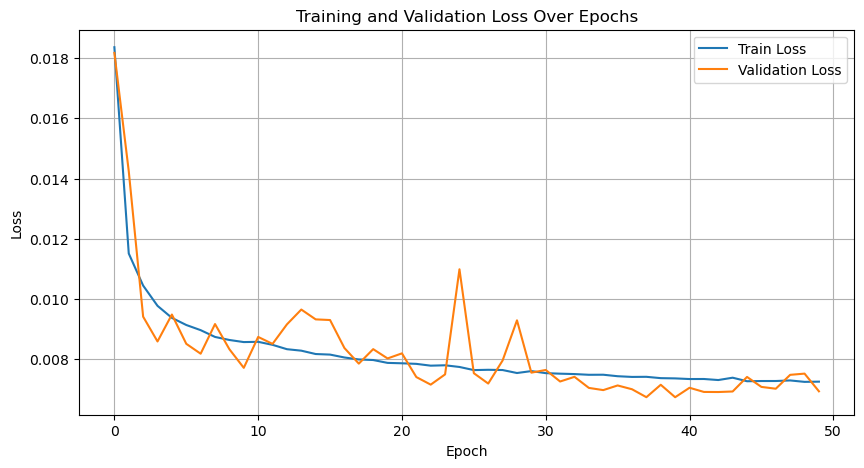

In [188]:
from torch.utils.data import TensorDataset, DataLoader, random_split

train_features_tensor = torch.tensor(train_features.values, dtype=torch.float32).unsqueeze(1)  # Add channel dimension
train_labels_tensor = torch.tensor(train_labels.values, dtype=torch.float32).unsqueeze(1)  # Reshape labels

# Splitting the dataset into training and validation sets
dataset = TensorDataset(train_features_tensor, train_labels_tensor)
train_size = int(0.8 * len(dataset))
val_size = len(dataset) - train_size
train_dataset, val_dataset = random_split(dataset, [train_size, val_size])

# Creating data loaders for training and validation sets
train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=32, shuffle=False)

def train_and_validate(model, criterion, optimizer, train_loader, val_loader, epochs, device):
    history = {'train_loss': [], 'val_loss': []}
    
    for epoch in range(epochs):
        # Training phase
        model.train()
        running_loss = 0.0
        for inputs, labels in train_loader:
            inputs, labels = inputs.to(device), labels.to(device)

            optimizer.zero_grad()
            outputs = model(inputs)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()
            running_loss += loss.item()
        
        train_loss = running_loss / len(train_loader)
        history['train_loss'].append(train_loss)

        # Validation phase
        model.eval()
        val_loss = 0.0
        with torch.no_grad():
            for inputs, labels in val_loader:
                inputs, labels = inputs.to(device), labels.to(device)
                outputs = model(inputs)
                loss = criterion(outputs, labels)
                val_loss += loss.item()

        val_loss = val_loss / len(val_loader)
        history['val_loss'].append(val_loss)

        print(f'Epoch {epoch + 1}/{epochs}, Train Loss: {train_loss:.6f}, Validation Loss: {val_loss:.6f}')

    return history

model = FCModel(num_features)
criterion = nn.L1Loss()  # MAE Loss
optimizer = optim.Adam(model.parameters(), lr=0.001)

# Training loop
num_epochs = 50
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
model.to(device)

# Train and validate the model
history = train_and_validate(model, criterion, optimizer, train_loader, val_loader, num_epochs, device)

torch.save(model, 'FCModel.pth')

# Plot the training history
plt.figure(figsize=(10, 5))
plt.plot(history['train_loss'], label='Train Loss')
plt.plot(history['val_loss'], label='Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training and Validation Loss Over Epochs')
plt.legend()
plt.grid(True)
plt.show()

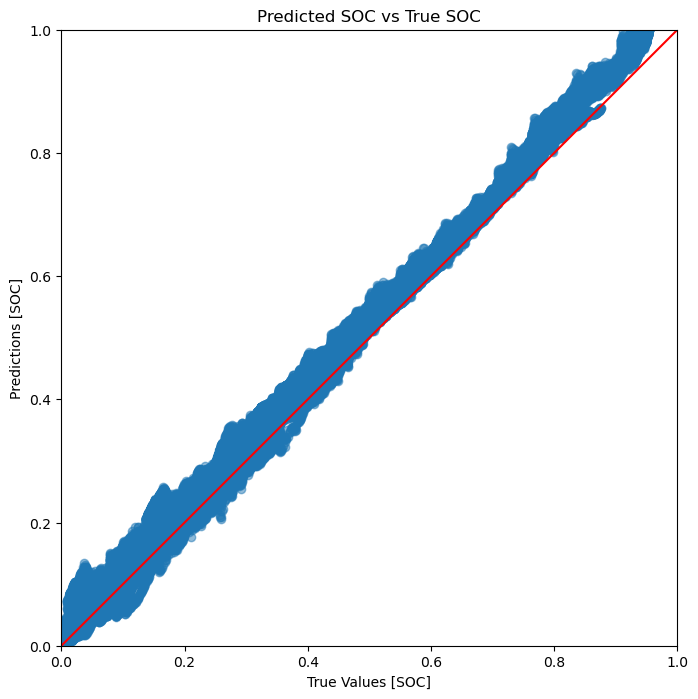

In [189]:
test_features_tensor = torch.tensor(test_features.values, dtype=torch.float32).unsqueeze(1)
# Create a DataLoader for the test set
test_loader = DataLoader(TensorDataset(test_features_tensor, test_labels_tensor), batch_size=64, shuffle=False)

model.to(device)

def test_model(model, test_loader, device):
    model = torch.load('FCModel.pth')
    model.eval()
    test_predictions = []
    test_targets = []
    
    with torch.no_grad():
        for inputs, labels in test_loader:
            inputs, labels = inputs.to(device), labels.to(device)
            outputs = model(inputs)
            test_predictions.extend(outputs.cpu().view(-1).tolist())
            test_targets.extend(labels.cpu().view(-1).tolist())  
    
    return test_predictions, test_targets

# Evaluate the model
test_predictions, test_targets = test_model(model, test_loader, device)

plt.figure(figsize=(8, 8))
plt.scatter(test_targets, test_predictions, alpha=0.5)
plt.xlabel('True Values [SOC]')
plt.ylabel('Predictions [SOC]')
plt.axis('equal')
plt.axis('square')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.plot([0, 1], [0, 1], color='red')  # Diagonal line
plt.title('Predicted SOC vs True SOC')
plt.show()

In [190]:
import plotly.graph_objects as go
import numpy as np

cycle_num = 0
steps_num = 100000
step_index = np.arange(cycle_num * steps_num, (cycle_num + 1) * steps_num)

# Ensure the sliced arrays are of equal length
min_length = min(len(test_predictions), len(test_targets), len(test_features['Temperature']))

fig = go.Figure()
fig.add_trace(go.Scatter(x=step_index[:min_length], y=test_predictions[:min_length], mode='lines', name='SOC Predicted'))
fig.add_trace(go.Scatter(x=step_index[:min_length], y=test_targets[:min_length], mode='lines', name='SOC Actual'))
fig.add_trace(go.Scatter(x=step_index[:min_length], y=test_features['Temperature'][:min_length], mode='lines', name='Temperature'))

fig.update_layout(title='Result on Test Dataset', xaxis_title='Step', yaxis_title='SOC Percentage')
fig.show()